# Renue
## Детекция отходов для переработки.

Renue – IT-компания из Екатеринбурга, разрабатывает на заказ высоконагруженные и отказоустойчивые решения для крупных российских заказчиков, для бизнеса и государства. В мире, где переработка отходов играет важную роль в защите окружающей среды, сортировка мусора является ключевым элементом в повышении эффективности перерабатывающих заводов. Это соревнование предлагает возможность разработать модель, способную автоматически определять различные типы мусора на сортировочном конвейере мусороперерабатывающего завода.

В качестве метрики качества используется взвешенный по классам mAP(50-95).

Проект выполняется на основе Kaggle. Для оптимизации использования ресурсов уместно разбить задачи на несколько тетрадей - подготовка данных, обучение, оценка тестовой выборки.

**План:**

1. Загрузить датасет.
2. Переформатировать изображения и аннотацию под YOLO.
3. Разработать функцию для кросс валидации.
4. Написать .yaml файл.
6. Оценить различные подходы к обучению на небольшом количестве эпох.
5. Обучить модель на основе YOLO11.
6. Провести оценку тестовой выборки с учётом необходимой памяти и результатов экспериментов.

# Тетрадь оценки теста (predict)

In [1]:
 !pip install ultralytics 

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 901.7/901.7 kB 22.5 MB/s eta 0:00:00


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os
from sklearn.model_selection import train_test_split 
from shutil import rmtree, copyfile

import yaml

In [3]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
RANDOM = 20241203
IMAGE_H = 1486
IMAGE_W = 2048

cmap = plt.get_cmap('tab20').colors
INPUT_DIR = "/kaggle/input/fork-of-renue-train-241219/"

### Sample

In [5]:
sample_submission = pd.read_csv('/kaggle/input/waste-detection/sample_submission.csv')
with pd.option_context('display.max_colwidth', None):
  display(sample_submission)

,file_name,bbox
0,000003.jpg,"[[5.0, 0.64, 536.1, 76.56, 834.52, 890.82], [5.0, 0.64, 536.1, 76.56, 834.52, 890.82]]"
1,000006.jpg,"[[4.0, 0.91, 397.68, 3.2, 218.05, 970.42], [4.0, 0.91, 397.68, 3.2, 218.05, 970.42]]"
2,000013.jpg,[]
3,000016.jpg,"[[8.0, 0.89, 587.89, 771.75, 636.26, 337.43], [8.0, 0.89, 587.89, 771.75, 636.26, 337.43]]"
4,000019.jpg,"[[7.0, 0.68, 75.08, 220.41, 982.22, 794.76], [7.0, 0.68, 75.08, 220.41, 982.22, 794.76]]"
...,...,...
2994,008986.jpg,"[[7.0, 0.1, 402.9, 964.16, 652.63, 273.57], [7.0, 0.1, 402.9, 964.16, 652.63, 273.57]]"
2995,008989.jpg,"[[4.0, 0.22, 12.38, 247.02, 954.12, 720.33], [4.0, 0.22, 12.38, 247.02, 954.12, 720.33]]"
2996,008991.jpg,"[[7.0, 0.37, 954.55, 592.88, 619.44, 212.06], [7.0, 0.37, 954.55, 592.88, 619.44, 212.06]]"
2997,008995.jpg,"[[14.0, 0.83, 185.66, 38.81, 170.07, 87.41], [14.0, 0.83, 185.66, 38.81, 170.07, 87.41]]"


In [6]:
sample_submission.loc[0, 'bbox']

'[[5.0, 0.64, 536.1, 76.56, 834.52, 890.82], [5.0, 0.64, 536.1, 76.56, 834.52, 890.82]]'

**Выводы:**

Пример файла для соревнования. Название файла в одном столбце. Список аннотаций в другом. Формат аннотаций `bbox`. Важно перевести из `yaml` перед сохранением.

### Holdout

In [7]:
holdout_df = pd.read_csv('/kaggle/input/waste-detection/test.csv')
holdout_df

,file_name
0,000003.jpg
1,000006.jpg
2,000013.jpg
3,000016.jpg
4,000019.jpg
...,...
2994,008986.jpg
2995,008989.jpg
2996,008991.jpg
2997,008995.jpg


In [8]:
holdout = list(holdout_df.file_name)

**Выводы:**

Список файлов в тестовом датасете.

### Class

In [9]:
trash_dict = {
    1: "PET (transparent) (green)",
    2: "PET (transparent) (brown)",
    3: "PET (transparent) (blue)",
    4: "PET (transparent)",
    5: "PET (transparent) (dark blue)",
    6: "PET (black)",
    7: "PET (white)",
    8: "PET (sticker)",
    9: "PET (flacon)",
    10: "PET (household chemicals)",
    11: "PND (household chemicals)",
    12: "PND packet",
    13: "Other plastic",
    14: "Other plastic (transparent)",
    15: "Not plastic"
}

**Выводы:**

Копия словаря для отображения.

## Samples prep

In [10]:
#last_run = os.path.join('/kaggle/working/Renue', last_run)
with open (INPUT_DIR + 'last_run.txt', 'r') as file:
    last_run = file.read()
last_run = os.path.join(INPUT_DIR,'Renue', os.path.basename(last_run), "weights/best.pt")
last_run

'/kaggle/input/fork-of-renue-train-241219/Renue/yolo11m_20241203_cycle4_fold5/weights/best.pt'

In [11]:
model = YOLO(last_run)
model.info()

YOLO11m summary: 409 layers, 20,064,573 parameters, 0 gradients, 68.2 GFLOPs


(409, 20064573, 0, 68.24883200000001)

In [12]:
holdout_img = [os.path.join('/kaggle/input/waste-detection/images', x) for x in holdout]
#holdout_img = holdout_img[:220] #demo
#holdout_img = holdout_img[:1] #demo

In [13]:
with open ('holdout.txt', 'w') as file:
    file.write('\n'.join(holdout_img))

In [14]:
predictions = model('holdout.txt', batch=.9, imgsz=1024, rect=True, stream=True)

**Выводы:**

Загружен файл с адресом последнего фолда. Изменён из `/working/` в `/input/`. Инициализирована модель весами. Сохранён список обрабатываемых изображений. 

Создан генератор для оценки изображений с параметрами соответствующими обучению и настройкой `stream=True`.

## Samples body

**Важно:** ниже клетка с оценкой теста имеет огромный вывод. Сохранён в оригинале для возможности ближе ознакомится. При работе с тетрадью лучше скрыть.

In [ ]:
long_boxes, output_imgs = [], []
for counter, result in enumerate(predictions):
    if counter%499 == 0:
        #result.show() # ломает тетрадь при скачивании из Kaggle
        output_imgs.append(result.path)
    boxes = result.boxes
    #result.show()
    long_boxes.append(
        str([x+y for x,y in zip(
            list(map(list, zip([x + 1 for x in boxes.cls.tolist()],
                               boxes.conf.tolist()))),
                               [[z[0], z[1], (z[2]-z[0]), (z[3]-z[1])]  for z in boxes.xyxy.tolist()])]))


image 1/2999 /kaggle/input/waste-detection/images/000003.jpg: 768x1024 1 PET (transparent) (brown), 2 PET (transparent)s, 46.8ms
image 2/2999 /kaggle/input/waste-detection/images/000006.jpg: 768x1024 1 PET (transparent) (brown), 2 PET (transparent)s, 28.0ms
image 3/2999 /kaggle/input/waste-detection/images/000013.jpg: 768x1024 1 PET (transparent) (brown), 2 PET (transparent)s, 1 PET (household chemicals), 27.8ms
image 4/2999 /kaggle/input/waste-detection/images/000016.jpg: 768x1024 2 PET (transparent) (brown)s, 1 PET (transparent), 1 PET (household chemicals), 27.9ms
image 5/2999 /kaggle/input/waste-detection/images/000019.jpg: 768x1024 1 PET (transparent) (green), 1 PET (transparent) (brown), 1 PET (transparent), 1 PET (household chemicals), 26.2ms
image 6/2999 /kaggle/input/waste-detection/images/000022.jpg: 768x1024 1 PET (transparent), 1 PET (household chemicals), 25.8ms
image 7/2999 /kaggle/input/waste-detection/images/000025.jpg: 768x1024 1 PET (transparent), 1 PET (household ch

In [16]:
sample_output = pd.read_csv('/kaggle/input/waste-detection/sample_submission.csv')
output = sample_output.copy()
##output = output.drop('bbox', axis=1)
output.bbox = pd.Series(long_boxes, name='bbox')
output.to_csv('prediction.csv', index=False)

**Выводы:**

Результат оценки два списка - один аннотации для соревнования, один изображения для демонстрации. Оценка происходит в рамках генератора, каждая итерация одно изображение.

Сохранён файл оценки `prediction.csv`.

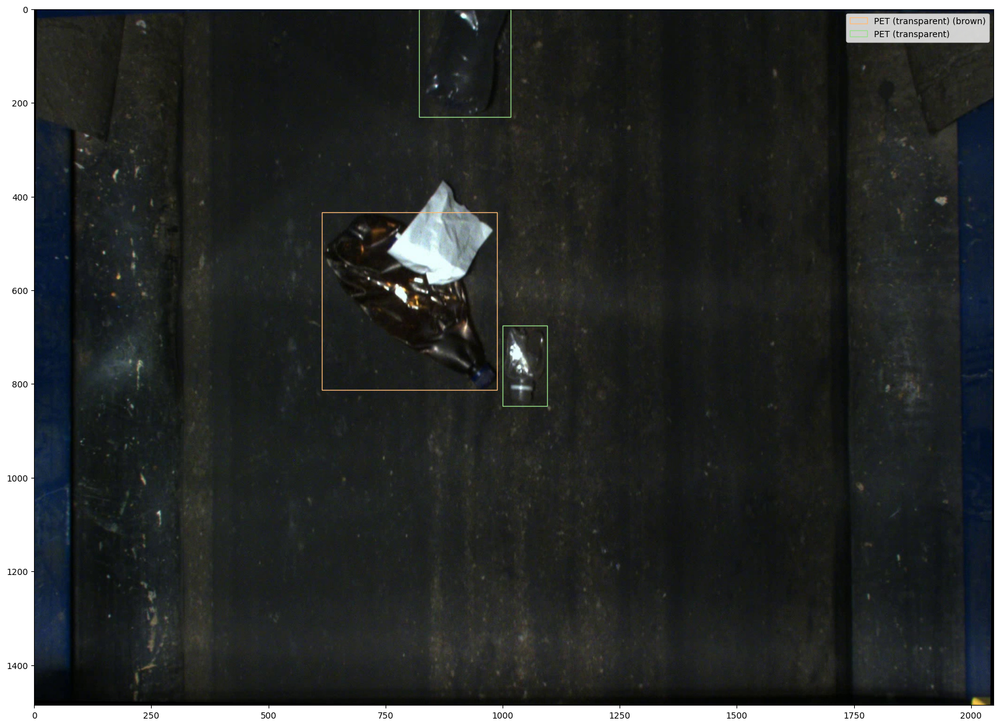

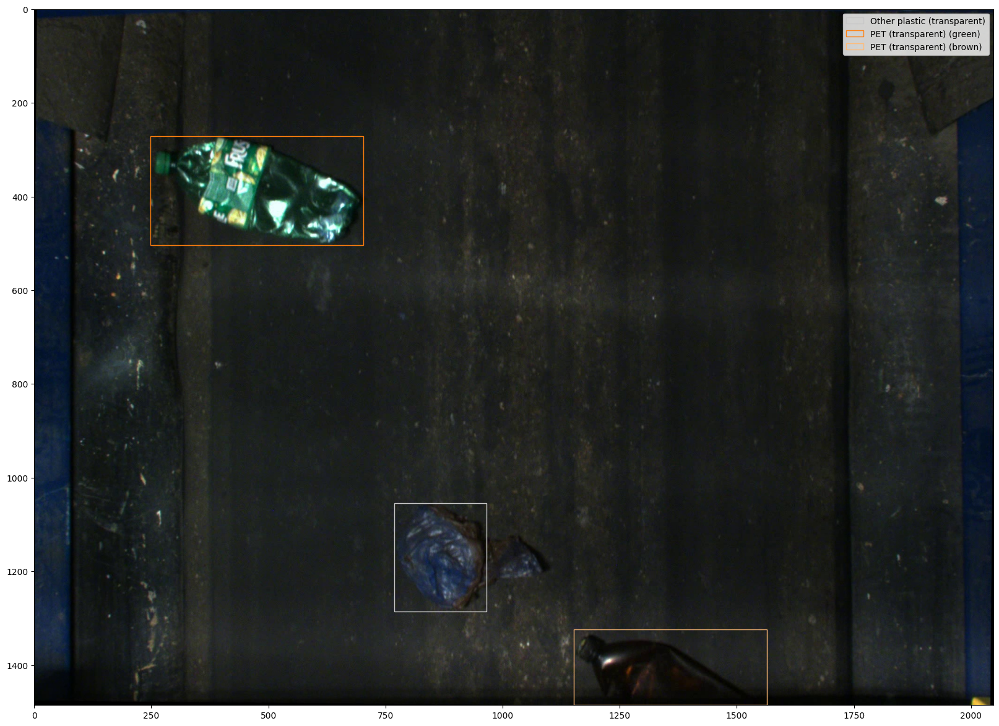

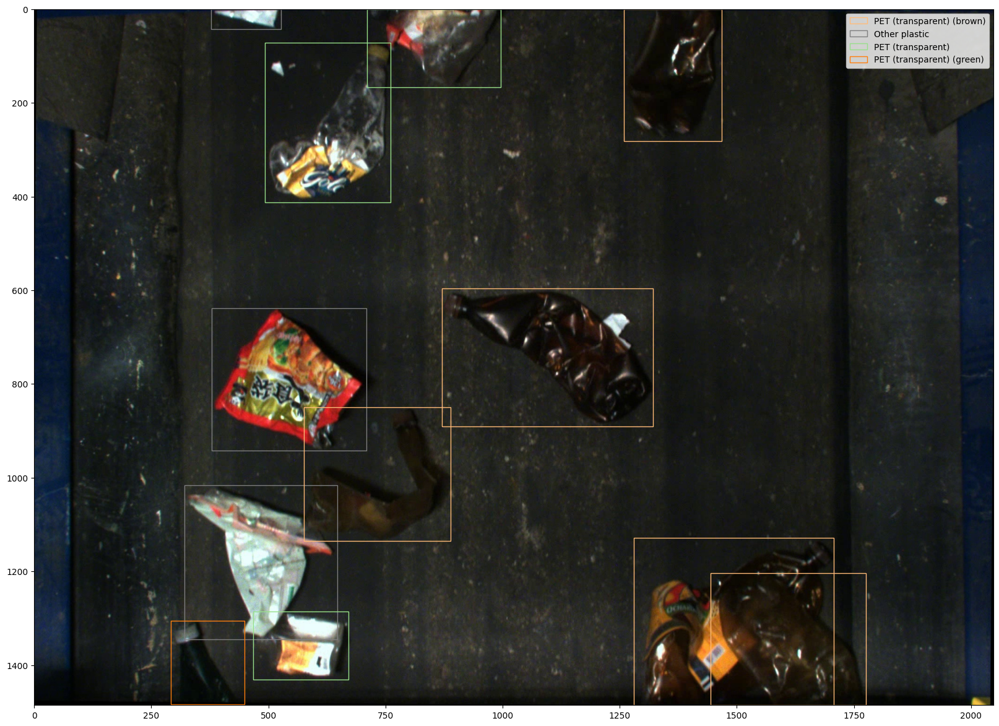

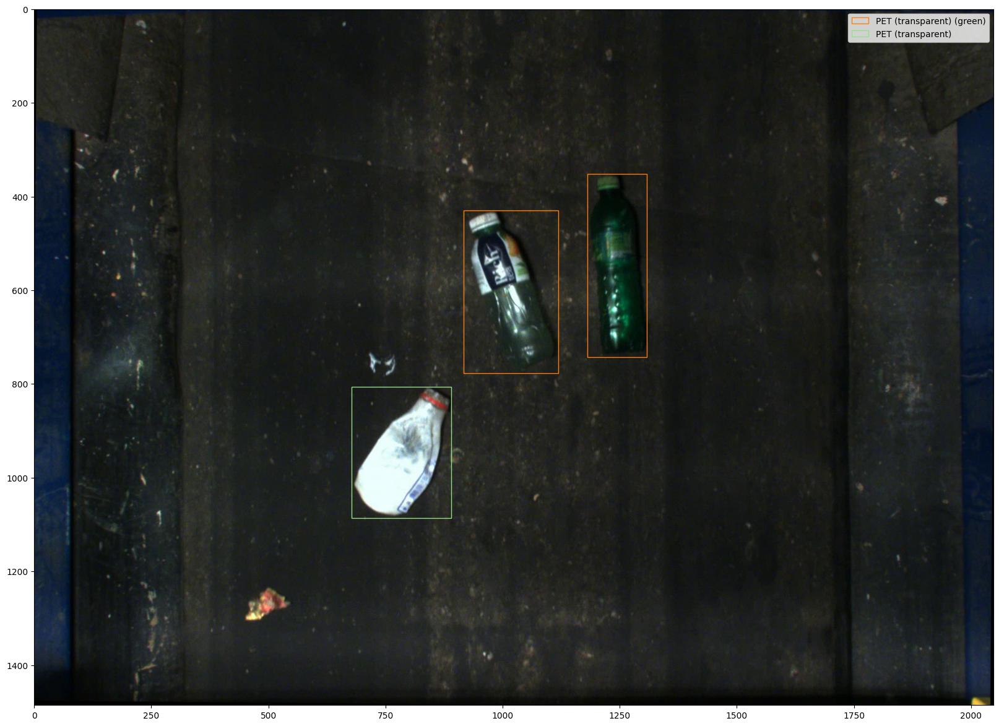

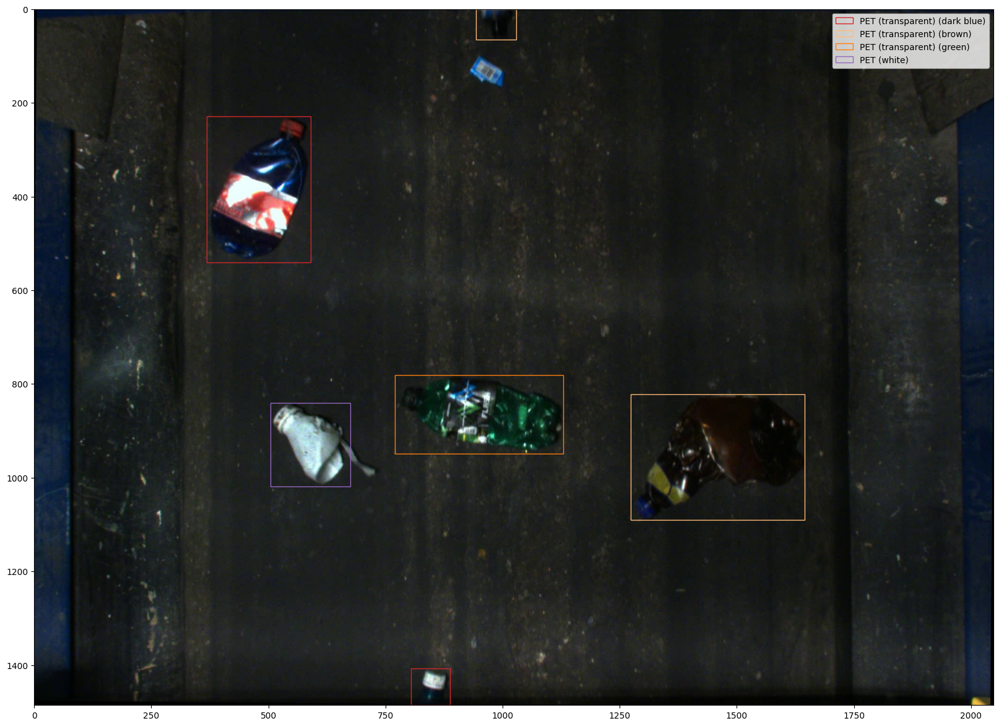

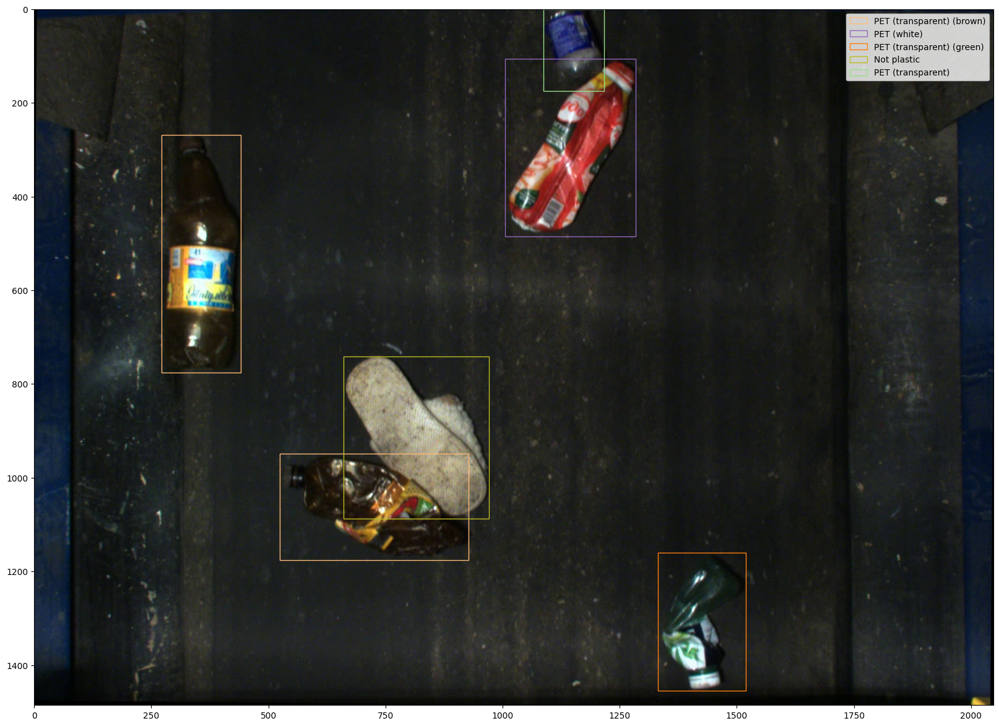

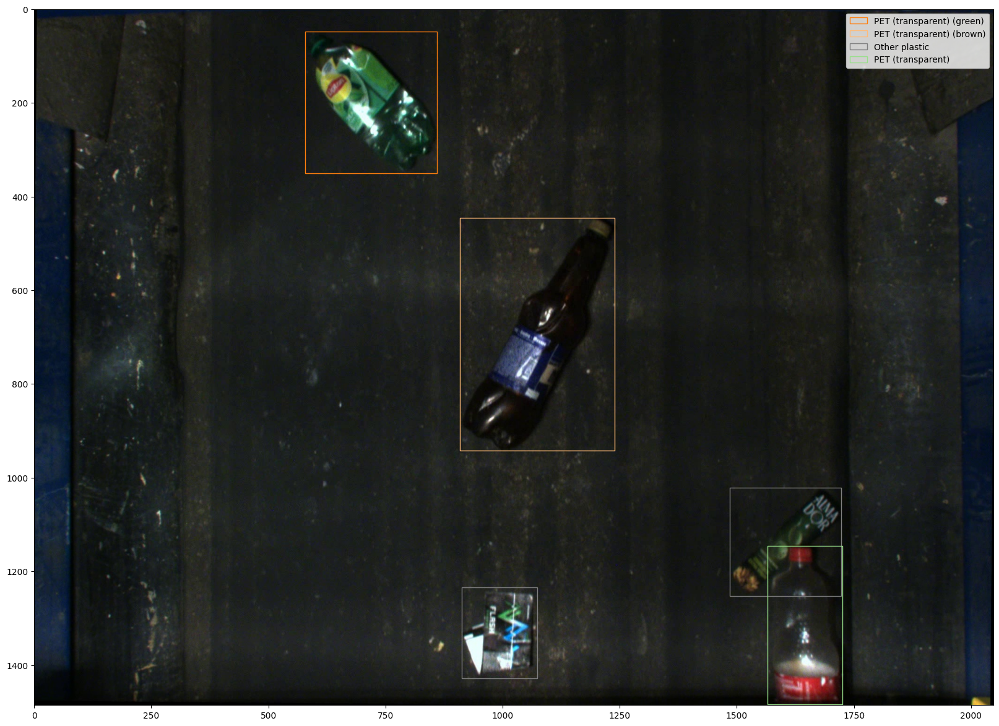

In [17]:
for pic in output_imgs:
    sample_p = pic
    sample_i = Image.open(sample_p)
    sample_fn = os.path.basename(sample_p)
    
    sample_sub = eval(output.query('file_name == @sample_fn')['bbox'].item())
    labels = set([])
    
    fig, ax = plt.subplots(figsize=(20, 20))
    
    ax.imshow(sample_i)
    
    for _ in range(len(sample_sub)):
        cat = sample_sub[_][0]
        cat_name = trash_dict[cat]
        label = cat_name if cat_name not in labels else ""
        labels.add(cat_name)
        rect = sample_sub[_][2:]
        rect = [[rect[0], rect[1]], rect[2], rect[3]]
        ax.add_patch(patches.Rectangle(*rect, linewidth=1, edgecolor=cmap[int(cat+1)], facecolor='none', label=label))
        
    
    ax.legend()
    plt.show()

**Выводы:**

Можно увидеть что модель лучше справляется с большими объектами, однако затрудняется с маленькими. 

## Заключение

Общая оценка текущего предсказания 0.811. Лучшего из всех экспериментов 0.846 (60 эпох, схожий подход, без `rect=True`)

Работа с изображениями требует большого объёма памяти. YOLO хранит в RAM результаты оценки во время предсказания и может этим вызывать серьёзные технические проблемы.

Различные способы подачи данных для обработки предсказанию не показали значительной разницы по времени. Проще всего использовать встроенный в YOLO `stream=`.

**Можно улучшить:**

Стоит попробовать запустить модель без кросс валидации, скорее всего сэкономит ресурсы и возможно большое количество циклов сыграет лучше чем текущий вариант.

Препроцессинг изображений для того чтобы маленькие элементы лучше видны были на фоне конвеера может помочь.

Возможно имеет смысл пересмотреть формат подачи изображений, чтобы использовать `StratifiedGroupKFold`.

Разобраться как использовать необычные метрики качества для YOLO11, возможно можно оптимизировать под взвешенную mAP(50-90) вместо mAP(50)

